In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import statsmodels.api as sm
sns.set()
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

import utilityfunctions

ModuleNotFoundError: No module named 'utilityfunctions'

In [2]:
db = pd.read_csv('../data/cleaned.csv', na_values=['?', None])
pd.options.display.max_columns = None
pd.options.display.max_rows = None

In [3]:
db.head()

,Unnamed: 0,Bearer Id,Start,Start ms,End,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Last Location Name,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Handset Manufacturer,Handset Type,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes),social_media,google,email,youtube,netflix,gaming,other,total_data
0,0,1.311448e+19,4/4/2019 12:01,770.0,4/25/2019 14:35,662.0,1823652.0,2.082014e+14,3.366496e+10,3.552121e+13,9.16456699548519E+015,42.0,5.0,23.0,44.0,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,37624.0,38787.0,1.823653e+09,Samsung,Samsung Galaxy A5 Sm-A520F,213.0,214.0,1545765.0,24420.0,1634479.0,1271433.0,3563542.0,137762.0,15854611.0,2501332.0,8198936.0,9656251.0,278082303.0,14344150.0,171744450.0,8814393.0,36749741.0,308879636.0,1570185.0,2905912.0,3701304.0,18355943.0,17855187.0,292426453.0,180558843.0,73499482.0
1,1,1.311448e+19,4/9/2019 13:04,235.0,4/25/2019 8:15,606.0,1365104.0,2.082019e+14,3.368185e+10,3.579401e+13,L77566A,65.0,5.0,16.0,26.0,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,168.0,3560.0,1.365104e+09,Samsung,Samsung Galaxy J5 (Sm-J530),971.0,1022.0,1926113.0,7165.0,3493924.0,920172.0,629046.0,308339.0,20247395.0,19111729.0,18338413.0,17227132.0,608750074.0,1170709.0,526904238.0,15055145.0,53800391.0,653384965.0,1933278.0,4414096.0,937385.0,39359124.0,35565545.0,609920783.0,541959383.0,107600782.0
2,2,1.311448e+19,4/9/2019 17:42,1.0,4/25/2019 11:58,652.0,1361762.0,2.082003e+14,3.376063e+10,3.528151e+13,D42335A,NaN,NaN,6.0,9.0,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,0.0,0.0,1.361763e+09,Samsung,Samsung Galaxy A8 (2018),751.0,695.0,1684053.0,42224.0,8535055.0,1694064.0,2690151.0,672973.0,19725661.0,14699576.0,17587794.0,6163408.0,229584621.0,395630.0,410692588.0,4215763.0,27883638.0,279807335.0,1726277.0,10229119.0,3363124.0,34425237.0,23751202.0,229980251.0,414908351.0,55767276.0
3,3,1.311448e+19,4/10/2019 0:31,486.0,4/25/2019 7:36,171.0,1321509.0,2.082014e+14,3.375034e+10,3.535661e+13,T21824A,NaN,NaN,44.0,44.0,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,3330.0,37882.0,1.321510e+09,undefined,undefined,17.0,207.0,644121.0,13372.0,9023734.0,2788027.0,1439754.0,631229.0,21388122.0,15146643.0,13994646.0,1097942.0,799538153.0,10849722.0,749039933.0,12797283.0,43324218.0,846028530.0,657493.0,11811761.0,2070983.0,36534765.0,15092588.0,810387875.0,761837216.0,86648436.0
4,4,1.311448e+19,4/12/2019 20:10,565.0,4/25/2019 10:40,954.0,1089009.0,2.082014e+14,3.369980e+10,3.540701e+13,D88865A,NaN,NaN,6.0,9.0,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,0.0,0.0,1.089009e+09,Samsung,Samsung Sm-G390F,607.0,604.0,862600.0,50188.0,6248284.0,1500559.0,1936496.0,173853.0,15259380.0,18962873.0,17124581.0,415218.0,527707248.0,3529801.0,550709500.0,13910322.0,38542814.0,569138589.0,912788.0,7748843.0,2110349.0,34222253.0,17539799.0,531237049.0,564619822.0,77085628.0


In [4]:
db["Start"], db["End"] = pd.to_datetime(db["Start"], format='%m/%d/%Y %H:%M', errors='coerce'),\
    pd.to_datetime(db["End"], format='%m/%d/%Y %H:%M', errors='coerce')

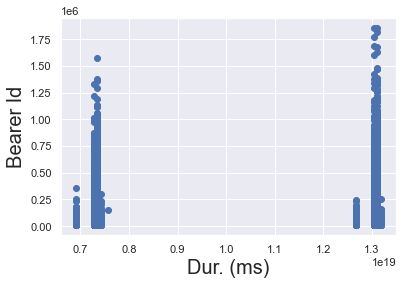

In [5]:
y = db['Dur. (ms)']
x1 = db['Bearer Id']

plt.scatter(x1,y)
plt.xlabel('Dur. (ms)', fontsize=20)
plt.ylabel('Bearer Id', fontsize = 20)
plt.show()

In [6]:
# Results will contain the output of the ordinary least squrares (OLS) regression

# fit() will apply a specific estimation techinque (OLS in this case) to obtain the fit of the model

x = sm.add_constant(x1)
results = sm.OLS(y,x).fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Dur. (ms)   R-squared:                      -0.120
Model:                            OLS   Adj. R-squared:                 -0.120
Method:                 Least Squares   F-statistic:                       nan
Date:                Sat, 17 Jul 2021   Prob (F-statistic):                nan
Time:                        22:18:40   Log-Likelihood:            -1.9168e+06
No. Observations:              150001   AIC:                         3.834e+06
Df Residuals:                  150000   BIC:                         3.834e+06
Df Model:                           0                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       8.717e-34   1.92e-36    454.998      0.000    8.68e-34    8.75e-34
Bearer Id   9.557e-15    2.1e-17    454.998      0.000    9.52e-15     9.6e-15
==============================================================================
Omnibus:                   115654.793   Durbin-Watson:                   0.245
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          5403415.181
Skew:                           3.304   Prob(JB):                         0.00
Kurtosis:                      31.651   Cond. No.                     3.84e+19
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.84e+19. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

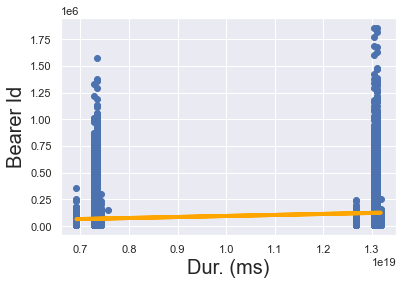

In [7]:
plt.scatter(x1,y)
yhat = 9.557e-15 * x1 + 8.717e-34
fig = plt.plot(x1,yhat, lw=4, c= 'orange', label = 'regression line')
plt.xlabel ('Dur. (ms)', fontsize = 20)
plt.ylabel ('Bearer Id', fontsize = 20)
plt.show()

In [8]:
# will give us the counts of unique values in day variable. 
# If we specify normalize=True inside the method, it will give us percentages instead.

db['Bearer Id'].value_counts(normalize=True)

1.304243e+19    0.000107
1.304243e+19    0.000067
1.304243e+19    0.000060
1.304243e+19    0.000060
1.304243e+19    0.000060
1.304243e+19    0.000060
1.304243e+19    0.000053
1.311448e+19    0.000053
1.304243e+19    0.000053
1.304243e+19    0.000053
1.304243e+19    0.000053
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.311448e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.311448e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.311448e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040


In [9]:
data_usage = db[["MSISDN/Number","Dur. (ms).1", "Total DL (Bytes)", "Total UL (Bytes)"]]

data_usage.groupby(["MSISDN/Number"]).agg('sum')

# This one aggregate total dl and total ul per misisdn number.

,Dur. (ms).1,Total DL (Bytes),Total UL (Bytes)
MSISDN/Number,,,
3.360100e+10,1.167201e+08,8.426375e+08,3.605311e+07
3.360100e+10,1.812310e+08,1.207552e+08,3.610446e+07
3.360100e+10,1.349694e+08,5.566597e+08,3.930682e+07
3.360101e+10,4.987802e+07,4.019932e+08,2.032753e+07
3.360101e+10,3.710445e+07,1.363130e+09,9.428053e+07
3.360101e+10,2.539831e+08,5.552080e+08,6.000925e+07
3.360101e+10,1.283605e+08,5.530412e+08,1.016819e+08
3.360101e+10,8.639998e+07,2.940851e+08,3.857528e+07
3.360101e+10,4.957021e+08,8.965602e+08,9.357202e+07


In [10]:
from sklearn.preprocessing import Normalizer, MinMaxScaler
from sklearn.cluster import KMeans


def normalizer(df, columns):
    norm = Normalizer()
    return pd.DataFrame(norm.fit_transform(df), columns=columns)

def scaler(df, columns):
    minmax_scaler = MinMaxScaler()
    return pd.DataFrame(minmax_scaler.fit_transform(df), columns=columns)

def scale_and_normalize(df,columns ):
    return normalizer(scaler(df, columns), columns)
    

In [11]:
engagment_metrics = db.groupby('MSISDN/Number').agg({'Bearer Id': 'count','Dur. (ms)': 'sum', 'total_data': 'sum',})
engagment_metrics = engagment_metrics.rename(columns={'Bearer Id': 'sessions_frequency', 'total_data': 'total_traffic'})
engagment_metrics.sort_values(by=['sessions_frequency'], ascending=False).head(10)

,sessions_frequency,Dur. (ms),total_traffic
MSISDN/Number,,,
3.362632e+10,1084,81336233.0,9.004916e+10
3.362578e+10,17,18553754.0,1.459155e+09
3.361489e+10,17,9966898.0,1.378966e+09
3.365973e+10,16,4035428.0,1.248521e+09
3.376054e+10,15,9279434.0,1.406957e+09
3.367588e+10,15,4865947.0,1.163138e+09
3.366716e+10,13,8744914.0,1.132653e+09
3.362708e+10,12,4703516.0,8.905039e+08
3.360452e+10,12,5207990.0,7.835517e+08


In [12]:
engagment_metrics.describe()


,sessions_frequency,Dur. (ms),total_traffic
count,106856.000000,1.068560e+05,1.068560e+05
mean,1.403768,1.468461e+05,1.154490e+08
std,3.408147,3.093849e+05,2.841911e+08
min,1.000000,7.142000e+03,5.733784e+06
25%,1.000000,7.130800e+04,7.279095e+07
50%,1.000000,1.027400e+05,9.358773e+07
75%,2.000000,1.727990e+05,1.314640e+08
max,1084.000000,8.133623e+07,9.004916e+10


In [13]:

def plot_box(df:pd.DataFrame, x_col:str, title:str) -> None:
    plt.figure(figsize=(12, 7))
    sns.boxplot(data = df, x=x_col)
    plt.title(title, size=20)
    plt.xticks(rotation=75, fontsize=14)
    plt.show()

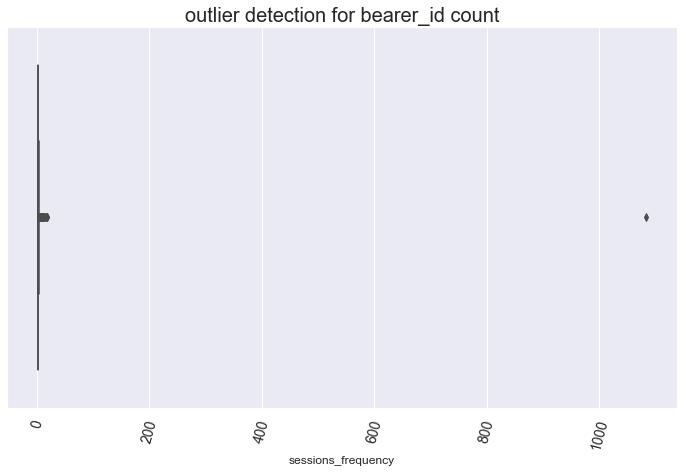

In [14]:
plot_box(engagment_metrics, 'sessions_frequency', 'outlier detection for bearer_id count')

In [15]:
def handle_outliers(df, col):
    df = df.copy()
    q1 = df[col].quantile(0.25)
    q3 = df[col].quantile(0.75)
    
    lower_bound = q1 - ((1.5) * (q3 - q1))
    upper_bound = q3 + ((1.5) * (q3 - q1))
    
    df[col] = np.where(df[col] < lower_bound, lower_bound, df[col])
    df[col] = np.where(df[col] > upper_bound, upper_bound, df[col])
    
    return df



In [16]:
cleaned_engagment_metrics = handle_outliers(engagment_metrics, 'sessions_frequency')
cleaned_engagment_metrics = handle_outliers(cleaned_engagment_metrics, 'Dur. (ms)')
cleaned_engagment_metrics = handle_outliers(cleaned_engagment_metrics, 'total_traffic')
cleaned_engagment_metrics.describe()


,sessions_frequency,Dur. (ms),total_traffic
count,106856.000000,106856.000000,1.068560e+05
mean,1.359582,130253.994394,1.083001e+08
std,0.653562,87611.985353,5.021541e+07
min,1.000000,7142.000000,5.733784e+06
25%,1.000000,71308.000000,7.279095e+07
50%,1.000000,102740.000000,9.358773e+07
75%,2.000000,172799.000000,1.314640e+08
max,3.500000,325035.500000,2.194735e+08


In [17]:
normalized_metrics = scale_and_normalize(cleaned_engagment_metrics, ['sessions_frequency', 'duration', 'total_traffic'])
normalized_metrics.describe()

,sessions_frequency,duration,total_traffic
count,106856.000000,106856.000000,106856.000000
mean,0.120346,0.549086,0.743574
std,0.202687,0.241667,0.177864
min,0.000000,0.000000,0.000000
25%,0.000000,0.390973,0.615457
50%,0.000000,0.577350,0.762862
75%,0.315022,0.735002,0.882337
max,0.765351,1.000000,1.000000


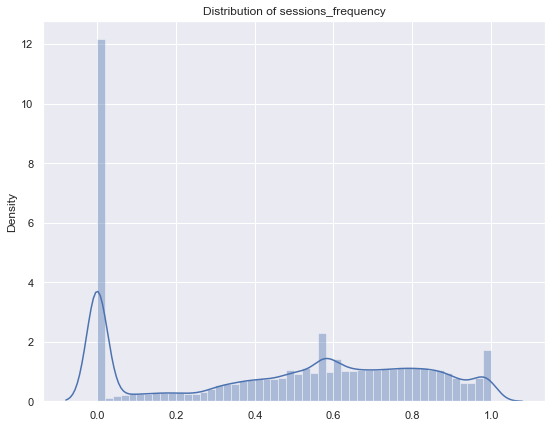

In [18]:
def plot_dist(df: pd.DataFrame, column: str):
    plt.figure(figsize=(9, 7))
    sns.distplot(df).set_title(f'Distribution of {column}')
    plt.show()
    
plot_dist(normalized_metrics, 'sessions_frequency',)

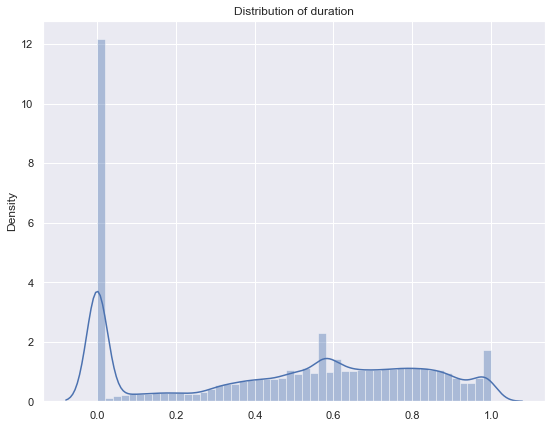

In [19]:
plot_dist(normalized_metrics, 'duration',)

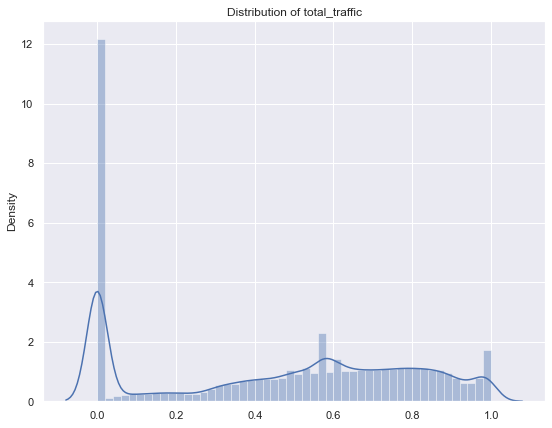

In [20]:
plot_dist(normalized_metrics, 'total_traffic',)

In [21]:
kmeans = KMeans(n_clusters=3, init='k-means++').fit(normalized_metrics)
pred = kmeans.predict(normalized_metrics)

engagment_metrics_with_cluster = cleaned_engagment_metrics.copy()
engagment_metrics_with_cluster['clusters'] = pred

In [22]:
def cluser_label(x: int, cols: list = []) -> str:
    if (not type(x) == int):
        return x
    if (x < len(cols)):
        return cols[x]

    return str(x)
    

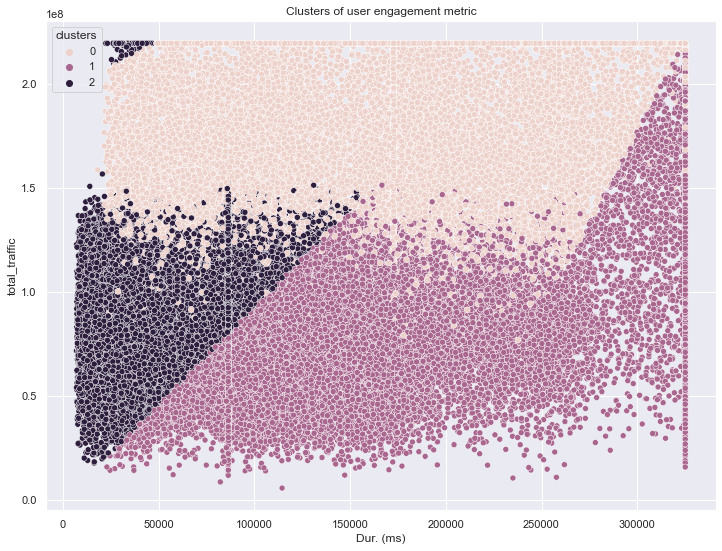

1    44322
2    36720
0    25814
Name: clusters, dtype: int64

In [23]:

# labels = ['cluser_1', 'cluser_2', 'cluser_3']

# engagment_metrics_with_cluster['clusters']  = engagment_metrics_with_cluster['clusters'].map(lambda x:
#                                                                                              cluser_label(x, labels))
engagment_metrics_with_cluster['clusters'].value_counts()

plt.figure(figsize=(12,9))

sns.scatterplot(x = 'Dur. (ms)', y='total_traffic',
                hue='clusters', data=engagment_metrics_with_cluster).set_title('Clusters of user engagement metric')

plt.show()
# engagment_metrics_with_cluster.describe()
engagment_metrics_with_cluster['clusters'].value_counts()


In [24]:
print("Describing cluser 1 ")
print("======================")
cluser_1 =  engagment_metrics_with_cluster[engagment_metrics_with_cluster['clusters'] == 0]
cluser_1.describe()


Describing cluser 1 


,sessions_frequency,Dur. (ms),total_traffic,clusters
count,25814.000000,25814.000000,2.581400e+04,25814.0
mean,2.360212,192782.240587,1.800806e+08,0.0
std,0.570023,91487.693647,3.512142e+07,0.0
min,2.000000,18235.000000,5.913970e+07,0.0
25%,2.000000,116721.750000,1.533749e+08,0.0
50%,2.000000,181786.500000,1.821648e+08,0.0
75%,3.000000,265492.250000,2.194735e+08,0.0
max,3.500000,325035.500000,2.194735e+08,0.0


In [25]:
print("Describing cluser 2 ")
print("======================")
cluser_1 =  engagment_metrics_with_cluster[engagment_metrics_with_cluster['clusters'] == 1]
cluser_1.describe()

Describing cluser 2 


,sessions_frequency,Dur. (ms),total_traffic,clusters
count,44322.000000,44322.000000,4.432200e+04,44322.0
mean,1.072898,156238.393947,8.122394e+07,1.0
std,0.259972,72239.297136,3.110848e+07,0.0
min,1.000000,22998.000000,5.733784e+06,1.0
25%,1.000000,97880.500000,6.185937e+07,1.0
50%,1.000000,139481.500000,7.608827e+07,1.0
75%,1.000000,178308.000000,9.401808e+07,1.0
max,2.000000,325035.500000,2.194735e+08,1.0


In [26]:
print("Describing cluser 3 ")
print("======================")
cluser_1 =  engagment_metrics_with_cluster[engagment_metrics_with_cluster['clusters'] == 2]
cluser_1.describe()

Describing cluser 3 


,sessions_frequency,Dur. (ms),total_traffic,clusters
count,36720.000000,36720.000000,3.672000e+04,36720.0
mean,1.002179,54933.060185,9.052044e+07,2.0
std,0.046626,30288.198003,2.189720e+07,0.0
min,1.000000,7142.000000,1.777360e+07,2.0
25%,1.000000,27374.750000,7.712521e+07,2.0
50%,1.000000,49938.500000,9.104601e+07,2.0
75%,1.000000,86399.000000,1.048572e+08,2.0
max,2.000000,153741.000000,2.194735e+08,2.0


In [27]:

app_metrics = []

app_columns = ['social_media', 'google', 'email', 'youtube', 'netflix', 'gaming']

app_metrics = db.groupby('MSISDN/Number').agg({'social_media': 'sum',
                                        'google': 'sum',
                                        'email': 'sum',
                                        'youtube': 'sum',
                                        'netflix': 'sum', 
                                        'gaming': 'sum'})


In [28]:

app_total_df = pd.DataFrame(columns=['app', 'total'])
app_total_df['app'] = app_columns

app_metrics
app_totals = [ ]
for app in app_columns:
    app_totals.append(app_metrics.sum()[app])
app_total_df['total'] =app_totals
    
app_total_df


,app,total
0,social_media,2.742394e+11
1,google,1.171102e+12
2,email,3.388676e+11
3,youtube,3.396545e+12
4,netflix,3.394314e+12
5,gaming,6.455040e+13


In [29]:
def plot_bar(df: pd.DataFrame, x_col: str, y_col: str, title: str, xlabel: str, ylabel: str) -> None:
    plt.figure(figsize=(9, 7))
    sns.barplot(data=df, x=x_col, y=y_col)
    plt.title(title, size=20)
    plt.xticks(rotation=75, fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlabel(xlabel, fontsize=16)
    plt.ylabel(ylabel, fontsize=16)
    plt.show()


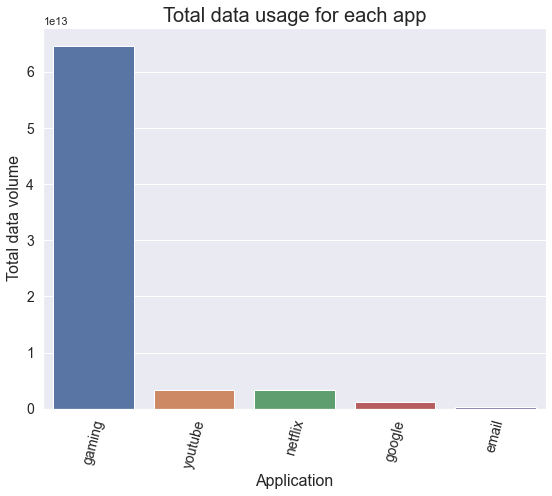

In [30]:
plot_bar(app_total_df.sort_values(by=['total'],
                                  ascending = False).head(),
         x_col='app', y_col='total', title="Total data usage for each app",
         xlabel="Application", ylabel="Total data volume")


In [31]:

inertias = []
for k in range(1, 20):
    
    kmeans = KMeans(n_clusters=k).fit(normalized_metrics)
    inertias.append([k, kmeans.inertia_])

    



Text(0, 0.5, 'Inertia')

<Figure size 720x504 with 0 Axes>

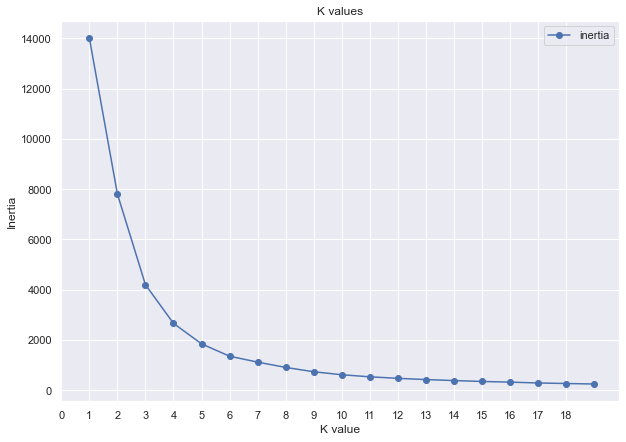

In [32]:

k_df = pd.DataFrame(columns=['k', 'inertia'])
k_df['k'] = [i[0] for i in inertias]
k_df['inertia'] = [i[1] for i in inertias]


plt.figure(figsize=(10,7))

k_df.plot( x='k', y='inertia', linestyle='-',
          marker='o', figsize=(10,7), title='K values').set_xlabel("K values")
plt.xticks(np.arange(len(k_df.index)))
plt.xlabel('K value')
plt.ylabel('Inertia')


# k_df.plot(inertias, linestyle='-', marker='o', )


In [33]:
kmeans_2 = KMeans(n_clusters=3, init='k-means++').fit(normalized_metrics)
pred = kmeans_2.predict(normalized_metrics)

engagment_metrics_with_cluster2 = cleaned_engagment_metrics.copy()
engagment_metrics_with_cluster2['clusters'] = pred

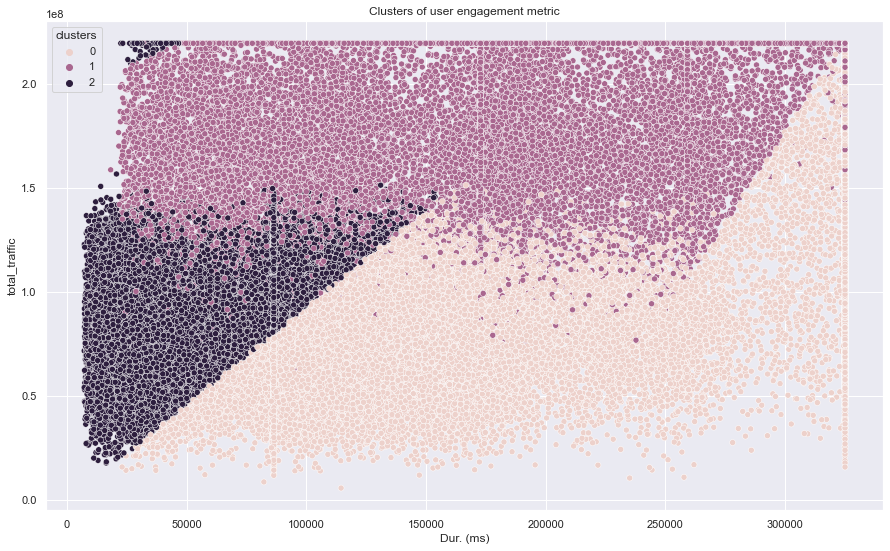

,sessions_frequency,Dur. (ms),total_traffic,clusters
count,106856.000000,106856.000000,1.068560e+05,106856.000000
mean,1.359582,130253.994394,1.083001e+08,1.102063
std,0.653562,87611.985353,5.021541e+07,0.758160
min,1.000000,7142.000000,5.733784e+06,0.000000
25%,1.000000,71308.000000,7.279095e+07,1.000000
50%,1.000000,102740.000000,9.358773e+07,1.000000
75%,2.000000,172799.000000,1.314640e+08,2.000000
max,3.500000,325035.500000,2.194735e+08,2.000000


In [34]:
# labels = ['cluser_1', 'cluser_2', 'cluser_3', 'cluser_4']

# engagment_metrics_with_cluster['clusters']  = engagment_metrics_with_cluster['clusters'].map(lambda x:
#                                                                                              cluser_label(x, labels))
engagment_metrics_with_cluster['clusters'].value_counts()
plt.figure(figsize=(15,9))

sns.scatterplot(x = 'Dur. (ms)', y='total_traffic',
                hue='clusters', data=engagment_metrics_with_cluster2).set_title('Clusters of user engagement metric')

plt.show()
engagment_metrics_with_cluster.describe()

In [39]:
db['MSISDN/Number'] = db['MSISDN/Number'].astype("category")
db['Handset Type'] = db['Handset Type'].astype("category")
cleaned_df = db

In [43]:
experience_df = cleaned_df[['MSISDN/Number', 'Avg RTT DL (ms)', 'Avg RTT UL (ms)', 
           'Avg Bearer TP DL (kbps)', 'Avg Bearer TP UL (kbps)', 'Handset Type']]

experience_df.head()

,MSISDN/Number,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),Handset Type
0,3.366496e+10,42.0,5.0,23.0,44.0,Samsung Galaxy A5 Sm-A520F
1,3.368185e+10,65.0,5.0,16.0,26.0,Samsung Galaxy J5 (Sm-J530)
2,3.376063e+10,NaN,NaN,6.0,9.0,Samsung Galaxy A8 (2018)
3,3.375034e+10,NaN,NaN,44.0,44.0,undefined
4,3.369980e+10,NaN,NaN,6.0,9.0,Samsung Sm-G390F


In [44]:
def handle_outliers(df, col, method="lower_upper"):
    df = df.copy()
    q1 = df[col].quantile(0.25)
    q3 = df[col].quantile(0.75)
    
    lower_bound = q1 - ((1.5) * (q3 - q1))
    upper_bound = q3 + ((1.5) * (q3 - q1))
    
    if method == "mean":
        df[col] = np.where(df[col] < lower_bound,   df[col].mean(), df[col])
        df[col] = np.where(df[col] > upper_bound, df[col].mean(), df[col])
    
    elif  method == "mode":
        df[col] = np.where(df[col] < lower_bound,   df[col].mode()[0], df[col])
        df[col] = np.where(df[col] > upper_bound, df[col].mode()[0], df[col])
    else:
        df[col] = np.where(df[col] < lower_bound, lower_bound, df[col])
        df[col] = np.where(df[col] > upper_bound, upper_bound, df[col])
    
    return df

In [47]:
cleaned_experience_df = handle_outliers(experience_df, 'Avg RTT DL (ms)', method="mean")
cleaned_experience_df = handle_outliers(experience_df, 'Avg RTT UL (ms)', method="mean")

cleaned_experience_df = handle_outliers(experience_df, 'Avg Bearer TP DL (kbps)', method="mean")
cleaned_experience_df = handle_outliers(experience_df, 'Avg Bearer TP UL (kbps)', method="mean")


In [48]:
cleaned_df.dtypes


Unnamed: 0                                 int64
Bearer Id                                float64
Start                             datetime64[ns]
Start ms                                 float64
End                               datetime64[ns]
End ms                                   float64
Dur. (ms)                                float64
IMSI                                     float64
MSISDN/Number                           category
IMEI                                     float64
Last Location Name                        object
Avg RTT DL (ms)                          float64
Avg RTT UL (ms)                          float64
Avg Bearer TP DL (kbps)                  float64
Avg Bearer TP UL (kbps)                  float64
DL TP < 50 Kbps (%)                      float64
50 Kbps < DL TP < 250 Kbps (%)           float64
250 Kbps < DL TP < 1 Mbps (%)            float64
DL TP > 1 Mbps (%)                       float64
UL TP < 10 Kbps (%)                      float64
10 Kbps < UL TP < 50

In [51]:
experience_metrics_df = pd.DataFrame(columns=['MSISDN/Number', 'Handset Type', 'Avg RTT DL (ms)',
                                              'avg_throughput_kbps', 'tcp_retrans_bytes'])

experience_metrics_df['avg_rtt_ms'] = cleaned_experience_df['Avg RTT DL (ms)'] + cleaned_experience_df['Avg RTT UL (ms)']
experience_metrics_df['avg_throughput_kbps'] = cleaned_experience_df['Avg Bearer TP DL (kbps)'] + cleaned_experience_df['Avg Bearer TP UL (kbps)']

experience_metrics_df['msisdn'] = cleaned_experience_df['MSISDN/Number']
experience_metrics_df['handset_type'] = cleaned_experience_df['Handset Type']

In [52]:
experience_metrics_df.head()

,MSISDN/Number,Handset Type,Avg RTT DL (ms),avg_throughput_kbps,tcp_retrans_bytes,avg_rtt_ms,msisdn,handset_type
0,NaN,NaN,NaN,67.0,NaN,47.0,3.366496e+10,Samsung Galaxy A5 Sm-A520F
1,NaN,NaN,NaN,42.0,NaN,70.0,3.368185e+10,Samsung Galaxy J5 (Sm-J530)
2,NaN,NaN,NaN,15.0,NaN,NaN,3.376063e+10,Samsung Galaxy A8 (2018)
3,NaN,NaN,NaN,88.0,NaN,NaN,3.375034e+10,undefined
4,NaN,NaN,NaN,15.0,NaN,NaN,3.369980e+10,Samsung Sm-G390F


In [53]:
experience_metrics_df.describe()

,avg_throughput_kbps,avg_rtt_ms
count,150001.000000,122161.000000
mean,13867.862210,127.024885
std,24522.265649,622.521925
min,0.000000,0.000000
25%,90.000000,38.000000
50%,125.000000,54.000000
75%,21028.417091,92.000000
max,379930.417091,96924.000000


In [54]:

experience_agg_by_customer = experience_metrics_df.groupby('msisdn').agg({'avg_rtt_ms': 'sum',
                                                                          'avg_throughput_kbps': 'sum',
                                                                          'tcp_retrans_bytes': 'sum', 
                                                                           'handset_type': lambda x: x.mode()[0]})

In [55]:
experience_agg_by_customer.head()

,avg_rtt_ms,avg_throughput_kbps,tcp_retrans_bytes,handset_type
msisdn,,,,
33601001722.0,46.0,76.000000,0,Huawei P20 Lite Huawei Nova 3E
33601001754.0,31.0,99.000000,0,Apple iPhone 7 (A1778)
33601002511.0,0.0,97.000000,0,undefined
33601007832.0,84.0,248.000000,0,Apple iPhone 5S (A1457)
33601008617.0,119.0,42205.417091,0,Apple iPhone Se (A1723)


In [56]:
tcp_trans = experience_agg_by_customer.sort_values(by=['tcp_retrans_bytes'], ascending=False)

top_10_tcp = tcp_trans.head(10)
bot_10_tcp = tcp_trans.tail(10)
most_tcp_frq = tcp_trans['tcp_retrans_bytes'].value_counts().head(10)

In [57]:
top_10_tcp[['tcp_retrans_bytes']]

,tcp_retrans_bytes
msisdn,
33601001722.0,0
33669138905.0,0
33669159170.0,0
33669158963.0,0
33669158559.0,0
33669158353.0,0
33669157841.0,0
33669156988.0,0
33669156909.0,0


In [58]:
bot_10_tcp[['tcp_retrans_bytes']]

,tcp_retrans_bytes
msisdn,
33659400654.0,0
33659400609.0,0
33659400378.0,0
33659400313.0,0
33659400021.0,0
33659399917.0,0
33659399844.0,0
33659399731.0,0
33659399655.0,0


In [59]:
tcp_rtt = experience_agg_by_customer.sort_values(by=['avg_rtt_ms'], ascending=False)

top_10_rtt = tcp_rtt.head(10)
bot_10_rtt = tcp_rtt.tail(10)
most_rtt_frq = tcp_rtt['avg_rtt_ms'].value_counts().head(10)


In [60]:
top_10_rtt[['avg_rtt_ms']]

,avg_rtt_ms
msisdn,
33626320676.0,306101.0
33662317023.0,96924.0
33660874265.0,64670.0
33683692867.0,54848.0
33698551167.0,46021.0
33761813523.0,37084.0
33668791629.0,36304.0
33760941100.0,27278.0
33606788933.0,26300.0


In [61]:
bot_10_rtt[['avg_rtt_ms']]

,avg_rtt_ms
msisdn,
33662288455.0,0.0
33662289075.0,0.0
33662294327.0,0.0
33662295833.0,0.0
33662296356.0,0.0
33750236009.0,0.0
33662297887.0,0.0
33662298430.0,0.0
33662298574.0,0.0


In [62]:
most_rtt_frq

0.0     18546
29.0     2778
39.0     2245
38.0     1541
30.0     1478
40.0     1466
28.0     1373
49.0     1268
31.0     1096
41.0     1095
Name: avg_rtt_ms, dtype: int64

In [63]:

tcp_throuput = experience_agg_by_customer.sort_values(by=['avg_throughput_kbps'], ascending=False)

top_10_throuput = tcp_throuput.head(10)
bot_10_throuput = tcp_throuput.tail(10)
most_rtt_throuput = tcp_throuput['avg_throughput_kbps'].value_counts().head(10)



In [64]:
top_10_throuput[['avg_throughput_kbps']]

,avg_throughput_kbps
msisdn,
33626320676.0,1.714307e+07
33762333464.0,8.595801e+05
33668708263.0,6.880757e+05
33659546392.0,6.850933e+05
33668425947.0,6.657687e+05
33698174760.0,6.123773e+05
33669946573.0,5.882907e+05
33625700673.0,5.627504e+05
33658581169.0,5.161238e+05


In [65]:
bot_10_throuput[['avg_throughput_kbps']]

,avg_throughput_kbps
msisdn,
33660500494.0,0.0
33650957457.0,0.0
33638414072.0,0.0
33698591046.0,0.0
33752920509.0,0.0
33777464744.0,0.0
33777761538.0,0.0
33660615626.0,0.0
33669225540.0,0.0


In [66]:
most_rtt_throuput

15.0    2685
63.0    2072
97.0    1023
90.0    1005
98.0     971
96.0     866
99.0     853
89.0     817
95.0     798
91.0     793
Name: avg_throughput_kbps, dtype: int64

In [67]:

handset_agg = experience_agg_by_customer.groupby('handset_type').agg({'avg_throughput_kbps': 'sum',
                                                                       'tcp_retrans_bytes': 'sum'})
handset_agg.head()


,avg_throughput_kbps,tcp_retrans_bytes
handset_type,,
A-Link Telecom I. Cubot A5,23510.0,0
A-Link Telecom I. Cubot Note Plus,6699.0,0
A-Link Telecom I. Cubot Note S,8937.0,0
A-Link Telecom I. Cubot Nova,56217.0,0
A-Link Telecom I. Cubot Power,69468.0,0


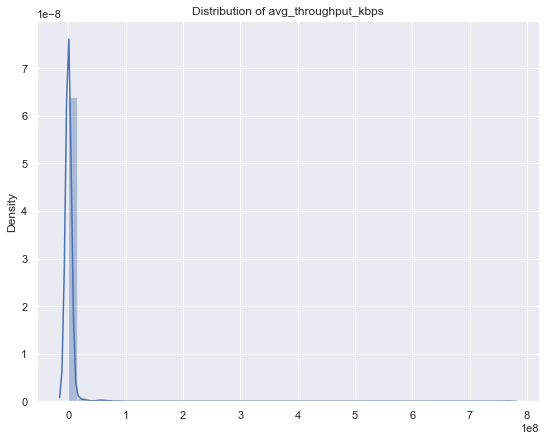

,avg_throughput_kbps,tcp_retrans_bytes
count,1.394000e+03,1394.0
mean,1.492248e+06,0.0
std,2.128149e+07,0.0
min,0.000000e+00,0.0
25%,2.567000e+03,0.0
50%,2.179200e+04,0.0
75%,1.006033e+05,0.0
max,7.664123e+08,0.0


In [69]:

plot_dist(handset_agg[['avg_throughput_kbps']], 'avg_throughput_kbps')
handset_agg.describe()


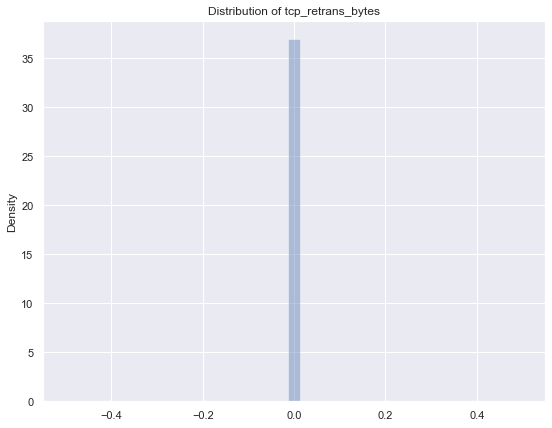

In [71]:
plot_dist(handset_agg[['tcp_retrans_bytes']], 'tcp_retrans_bytes')


In [72]:
from sklearn.preprocessing import Normalizer, MinMaxScaler
from sklearn.cluster import KMeans


def normalizer(df, columns):
    norm = Normalizer()
    return pd.DataFrame(norm.fit_transform(df), columns=columns)

def scaler(df, columns):
    minmax_scaler = MinMaxScaler()
    return pd.DataFrame(minmax_scaler.fit_transform(df), columns=columns)

def scale_and_normalize(df,columns ):
    return normalizer(scaler(df, columns), columns)

In [73]:
def cluser_label(x: int, cols: list = []) -> str:
    if (not type(x) == int):
        return x
    if (x < len(cols)):
        return cols[x]

    return str(x)

In [74]:

metrics = experience_agg_by_customer[['avg_rtt_ms', 'avg_throughput_kbps', 'tcp_retrans_bytes']]
normalized_metrics = scale_and_normalize(metrics, ['avg_rtt_ms', 'avg_throughput_kbps', 'tcp_retrans_bytes'])
normalized_metrics.describe()


,avg_rtt_ms,avg_throughput_kbps,tcp_retrans_bytes
count,106856.000000,106856.000000,106856.0
mean,0.526481,0.580342,0.0
std,0.435175,0.442319,0.0
min,0.000000,0.000000,0.0
25%,0.074650,0.055465,0.0
50%,0.467370,0.881694,0.0
75%,0.998443,0.997167,0.0
max,1.000000,1.000000,0.0


In [75]:
kmeans = KMeans(n_clusters=3, init='k-means++').fit(normalized_metrics)
pred = kmeans.predict(normalized_metrics)

experience_metrics_with_cluster = experience_agg_by_customer.copy()
experience_metrics_with_cluster['clusters'] = pred
experience_metrics_with_cluster['clusters'].value_counts()

1    51012
0    45084
2    10760
Name: clusters, dtype: int64

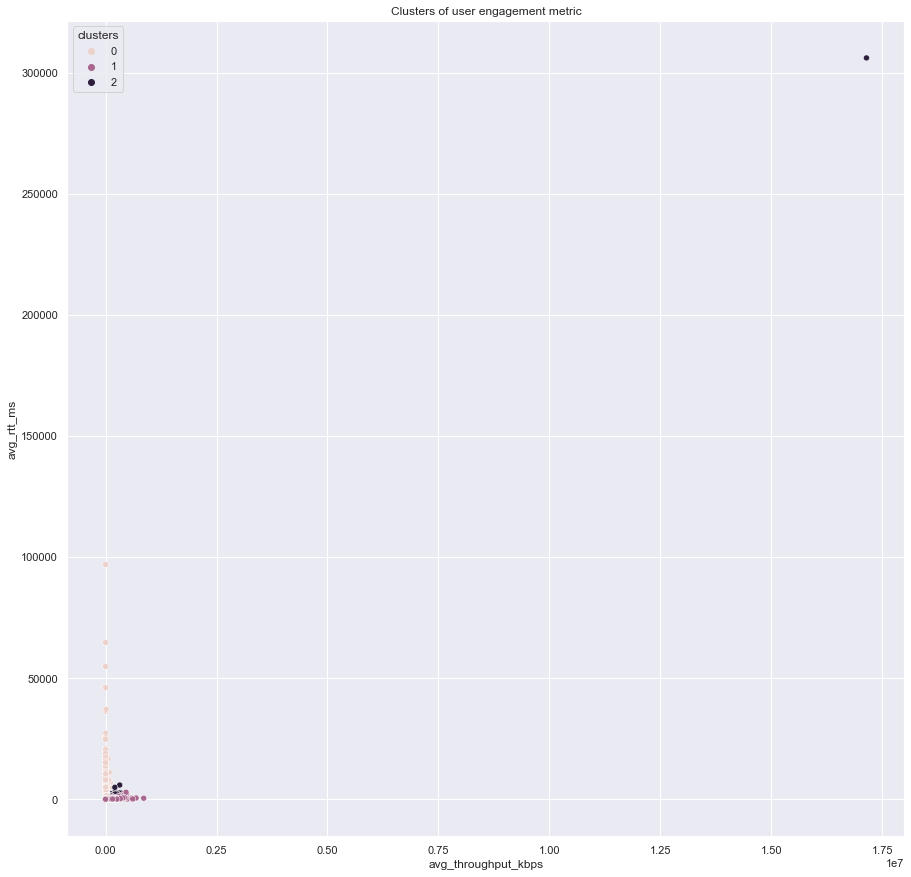

In [76]:
# labels = ['cluser_1', 'cluser_2', 'cluser_3']

# experience_metrics_with_cluster['clusters']  = experience_metrics_with_cluster['clusters'].map(lambda x:
#                                                                                              cluser_label(x, labels))

plt.figure(figsize=(15,15))

sns.scatterplot(x = 'avg_throughput_kbps', y='avg_rtt_ms',
                hue='clusters', data=experience_metrics_with_cluster).set_title('Clusters of user engagement metric')

plt.show()


In [77]:
fig = px.scatter(experience_metrics_with_cluster, x='tcp_retrans_bytes', y="avg_throughput_kbps",
                 color='clusters', size='avg_throughput_kbps')
fig.show()